# Fruit Freshness Classification Model Building
## B21-CAP0354

## Import libraries

In [1]:
!pip install kaggle

In [38]:
import pandas as pd
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_datasets as tfds
import random
from keras.preprocessing import image

In [3]:
# Check whether GPU is available (Colab has TPU so we might be using it)
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [4]:
# Mounting Google Drive to Colab (using Bangkit account)
from google.colab import drive
from google.colab import files

drive.mount('/gdrive')
# files.upload()

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


In [5]:
import os
os.getcwd()
os.environ['KAGGLE_CONFIG_DIR'] = '/gdrive/MyDrive/Kaggle'

## Import datasets

In [9]:
os.chdir('/gdrive/MyDrive/Kaggle')

!kaggle datasets download -d sriramr/fruits-fresh-and-rotten-for-classification
# !kaggle datasets download -d jorgebailon/fruits-vegetables

os.chdir('/content')

fruits-fresh-and-rotten-for-classification.zip: Skipping, found more recently modified local copy (use --force to force download)


### Fruits fresh and rotten

In [10]:
!cp '/gdrive/MyDrive/Kaggle/fruits-fresh-and-rotten-for-classification.zip' .
!unzip -q 'fruits-fresh-and-rotten-for-classification.zip'
!rm 'fruits-fresh-and-rotten-for-classification.zip'

In [11]:
os.chdir('/content/dataset')
!rm -rf 'dataset'

In [16]:
os.chdir('/content')
!cp '/gdrive/MyDrive/Kaggle/extraDataset.zip' .
!unzip -q 'extraDataset.zip'
!rm 'extraDataset.zip'

### Fruits & vegetables (unclassified for freshness)

In [ ]:
# !cp '/gdrive/MyDrive/Kaggle/fruits-vegetables.zip' .
# !unzip -q '/gdrive/MyDrive/Kaggle/fruits-vegetables.zip'
# !rm 'fruits-vegetables.zip'

## Managing dataset folders

### Checking amount of images

In [6]:
class_names = sorted(os.listdir('/content/dataset/train/'))
print(class_names)

['freshapples', 'freshbanana', 'freshlemon', 'freshoranges', 'rottenapples', 'rottenbanana', 'rottenlemon', 'rottenoranges', 'uncategorized']


In [7]:
def list_dir(class_names, slice='train'):
  return os.listdir('/content/dataset/{}/{}'.format(slice, class_names))

for i in class_names:
  print(i)
  print(len(list_dir(i, 'train')))
  print(len(list_dir(i, 'test')))

freshapples
1488
395
freshbanana
1344
381
freshlemon
240
200
freshoranges
1172
388
rottenapples
1873
601
rottenbanana
1779
530
rottenlemon
232
180
rottenoranges
1276
403
uncategorized
177
240


## Visualizing images

In [8]:
%matplotlib inline

import matplotlib.image as mpimg
import matplotlib.pyplot as plt

# Parameters for our graph; we'll output images in a 4x4 configuration
nrows = 9
ncols = 6

pic_index = 0 # Index for iterating over images

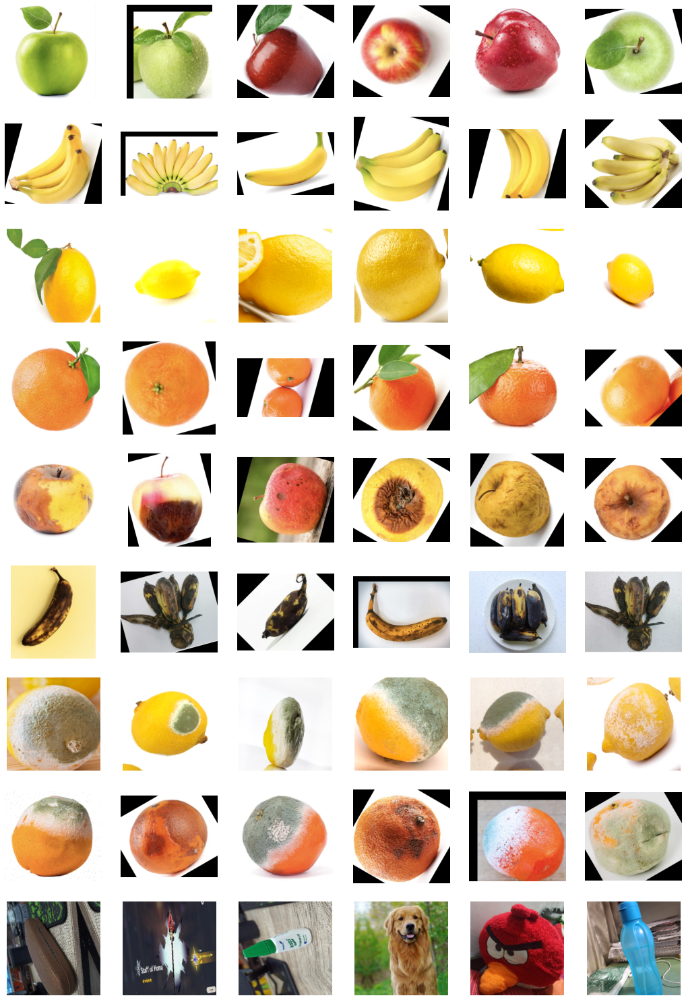

In [9]:
# Set up matplotlib fig, and size it to fit 4x4 pics
fig = plt.gcf()
fig.set_size_inches(ncols*3, nrows*3)

dirs = []

for i in class_names:
  path = '/content/dataset/train/{}/'.format(i)
  dir = list_dir(i, 'train')
  for fileName in dir[pic_index:pic_index+6]:
    dirs.append(path+fileName)

pic_index+=6

for i, img_path in enumerate(dirs):
  # Set up subplot; subplot indices start at 1
  sp = plt.subplot(nrows, ncols, i+1)
  sp.axis('Off') # Don't show axes (or gridlines)
  img = mpimg.imread(img_path)
  plt.imshow(img)

plt.show()

### Shuffling training data for validation (Probably not used)



In [30]:
try:
  os.mkdir('/content/dataset/validation')
except:
  print('Folder already available')

In [31]:
from shutil import copyfile

def create_validation(SOURCE, DEST, SPLIT_SIZE):
    valid_data = []
    for file in os.listdir(SOURCE):
        filename = SOURCE + file
        if os.path.getsize(filename) > 0:
            valid_data.append(file)
    
    train_size = int(SPLIT_SIZE * len(valid_data))
    validation_size = int((1-SPLIT_SIZE) * len(valid_data))
    randomized = random.sample(valid_data, len(valid_data))
    training = randomized[:train_size]
    testing = randomized[-(validation_size+1):]
        
    for i in testing:
        sourceFile = SOURCE + i
        target = DEST + i
        copyfile(sourceFile, target)
        os.remove(sourceFile)

In [32]:
SOURCE = '/content/dataset/train/'
DEST = '/content/dataset/validation/'
SPLIT_SIZE = 0.8

for name in class_names:
  src = SOURCE + name + '/'
  trg = DEST + name + '/'
  try:
    os.mkdir(trg)
  except:
    print('Validation directory already exists')
  create_validation(src, trg, SPLIT_SIZE)

In [33]:
for i in class_names:
  print(i)
  print(len(list_dir(i, 'train')))
  print(len(list_dir(i, 'validation')))
  print(len(list_dir(i, 'test')))

freshapples
1488
373
395
freshbanana
1344
337
381
freshlemon
240
60
200
freshoranges
1172
294
388
rottenapples
1873
469
601
rottenbanana
1779
445
530
rottenlemon
232
58
180
rottenoranges
1276
319
403
uncategorized
177
45
240


## Pre-process train & test images

In [10]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [11]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=[0.5, 1.0],
    fill_mode='nearest',
)

test_datagen = ImageDataGenerator(
    rescale=1./255
)

validation_datagen = ImageDataGenerator(
    rescale=1./255
)

In [12]:
train_dir = '/content/dataset/train/'
test_dir = '/content/dataset/test/'
validation_dir = '/content/dataset/validation/'

train_flow = train_datagen.flow_from_directory(
    train_dir,
    batch_size=64,
    target_size=(224,224),
    class_mode='categorical',
)
validation_flow = validation_datagen.flow_from_directory(
    validation_dir,
    batch_size=32,
    target_size=(224,224),
    class_mode='categorical',
)
test_flow = test_datagen.flow_from_directory(
    test_dir,
    batch_size=32,
    target_size=(224,224),
    shuffle=False,
    class_mode='categorical',
)

train_steps = 9581 // 64
val_steps = 2400 // 32
test_steps = 3318 // 32

Found 9581 images belonging to 9 classes.
Found 2400 images belonging to 9 classes.
Found 3318 images belonging to 9 classes.


## Model Building
Using Transfer Learning to reduce training time, and improve accuracy

In [13]:
# Model selections
# https://tfhub.dev/google/imagenet/mobilenet_v3_large_100_224/feature_vector/5
# https://tfhub.dev/google/imagenet/mobilenet_v3_large_100_224/classification/5

PRETRAINED_MODEL = 'https://tfhub.dev/google/imagenet/mobilenet_v3_large_100_224/feature_vector/5'
IMAGE_SIZE = (224, 224, 3)
OUTPUT_SHAPE = [1280]

In [60]:
model = tf.keras.Sequential(
    [
     hub.KerasLayer('https://tfhub.dev/google/imagenet/mobilenet_v3_large_100_224/feature_vector/5',
                    input_shape=IMAGE_SIZE,
                    output_shape=OUTPUT_SHAPE,
                    trainable=False,
                    ),
     tf.keras.layers.Flatten(),
     tf.keras.layers.Dense(units=512, activation='relu'),
     tf.keras.layers.Dropout(0.2),
     tf.keras.layers.Dense(units=64, activation='relu'),
     tf.keras.layers.Dense(units=9, activation='softmax'),
    ]
)

model.compile(optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0015), 
              loss='categorical_crossentropy',
              metrics=['accuracy'])

model.summary()

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer_4 (KerasLayer)   (None, 1280)              4226432   
_________________________________________________________________
flatten_6 (Flatten)          (None, 1280)              0         
_________________________________________________________________
dense_17 (Dense)             (None, 512)               655872    
_________________________________________________________________
dropout_7 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_18 (Dense)             (None, 64)                32832     
_________________________________________________________________
dense_19 (Dense)             (None, 9)                 585       
Total params: 4,915,721
Trainable params: 689,289
Non-trainable params: 4,226,432
______________________________________

In [24]:
model2 = tf.keras.Sequential(
    [
     tf.keras.layers.Conv2D(16, (3,3), activation='relu', input_shape=IMAGE_SIZE),
     tf.keras.layers.MaxPooling2D((2,2)),
     tf.keras.layers.Conv2D(32, (3,3), activation='relu'),
     tf.keras.layers.MaxPooling2D((2,2)),
     tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
     tf.keras.layers.MaxPooling2D((2,2)),
     tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
     tf.keras.layers.MaxPooling2D((2,2)),
     tf.keras.layers.Flatten(),
     tf.keras.layers.Dense(units=256, activation='relu'),
     tf.keras.layers.Dropout(0.2),
     tf.keras.layers.Dense(units=9, activation='softmax')
    ]
)

model2.compile(optimizer=tf.keras.optimizers.Adam(), 
              loss='categorical_crossentropy',
              metrics=['accuracy'])

model2.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 222, 222, 16)      448       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 111, 111, 16)      0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 109, 109, 32)      4640      
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 54, 54, 32)        0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 52, 52, 64)        18496     
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 26, 26, 64)        0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 24, 24, 64)       

### Creating callback

In [61]:
class myCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs={}):
    if(logs.get('accuracy') > 0.985):
      print('Target accuracy acquired!')
      self.model.stop_training = True

### Model fitting and evaluating

In [62]:
callbacks = myCallback()
history = model.fit(train_flow, 
                    epochs=15, 
                    verbose=1, 
                    validation_data=validation_flow, 
                    callbacks=[callbacks], 
                    steps_per_epoch=train_steps, 
                    validation_steps=val_steps
                    )

Epoch 1/15
149/149 [==============================] - 120s 783ms/step - loss: 0.1652 - accuracy: 0.9450 - val_loss: 0.0677 - val_accuracy: 0.9792
Epoch 2/15
149/149 [==============================] - 116s 776ms/step - loss: 0.0522 - accuracy: 0.9816 - val_loss: 0.0349 - val_accuracy: 0.9887
Epoch 3/15
149/149 [==============================] - 116s 776ms/step - loss: 0.0418 - accuracy: 0.9868 - val_loss: 0.0685 - val_accuracy: 0.9846
Target accuracy acquired!


Text(0.5, 1.0, 'Accuracy')

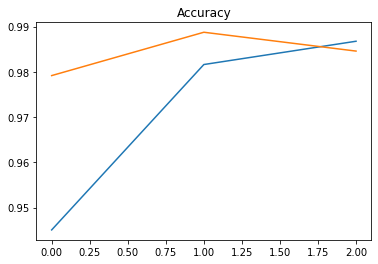

In [63]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc)
plt.plot(epochs, val_acc)
plt.title('Accuracy')

Text(0.5, 1.0, 'Loss')

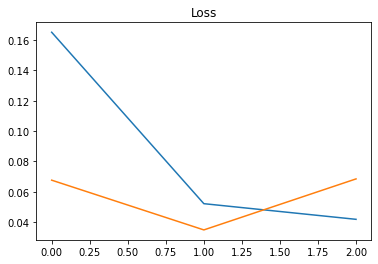

In [64]:
plt.plot(epochs, loss)
plt.plot(epochs, val_loss)
plt.title('Loss')

In [30]:
class myCallback(tf.keras.callbacks.Callback):
  def on_epoch_end(self, epoch, logs={}):
    if(logs.get('accuracy') > 0.955):
      print('Target accuracy acquired!')
      self.model.stop_training = True

In [31]:
history = model2.fit(train_flow, epochs=25, verbose=1, validation_data=validation_flow, callbacks=[callbacks], steps_per_epoch=train_steps, validation_steps=val_steps)

Epoch 1/25
149/149 [==============================] - 116s 776ms/step - loss: 1.1053 - accuracy: 0.5963 - val_loss: 0.6137 - val_accuracy: 0.7867
Epoch 2/25
149/149 [==============================] - 115s 773ms/step - loss: 0.5399 - accuracy: 0.8137 - val_loss: 0.3923 - val_accuracy: 0.8529
Epoch 3/25
149/149 [==============================] - 115s 775ms/step - loss: 0.4313 - accuracy: 0.8470 - val_loss: 0.3310 - val_accuracy: 0.8829
Epoch 4/25
149/149 [==============================] - 115s 774ms/step - loss: 0.3511 - accuracy: 0.8792 - val_loss: 0.2526 - val_accuracy: 0.9146
Epoch 5/25
149/149 [==============================] - 115s 775ms/step - loss: 0.3245 - accuracy: 0.8843 - val_loss: 0.2450 - val_accuracy: 0.9104
Epoch 6/25
149/149 [==============================] - 115s 772ms/step - loss: 0.3029 - accuracy: 0.8898 - val_loss: 0.2972 - val_accuracy: 0.9021
Epoch 7/25
149/149 [==============================] - 115s 773ms/step - loss: 0.2605 - accuracy: 0.9060 - val_loss: 0.2371 -

Text(0.5, 1.0, 'Accuracy')

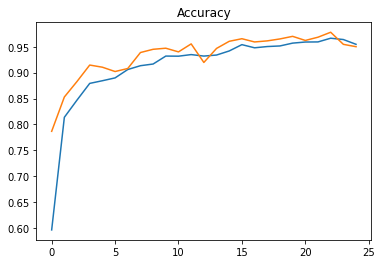

In [32]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc)
plt.plot(epochs, val_acc)
plt.title('Accuracy')

Text(0.5, 1.0, 'Loss')

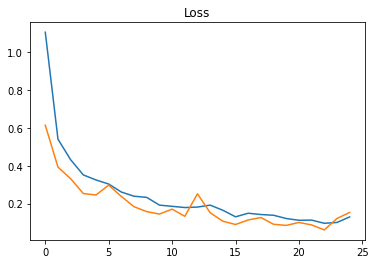

In [33]:
plt.plot(epochs, loss)
plt.plot(epochs, val_loss)
plt.title('Loss')

In [69]:
model.evaluate(test_flow, verbose=1)
model2.evaluate(test_flow, verbose=1)

104/104 [==============================] - 13s 124ms/step - loss: 0.3598 - accuracy: 0.9099


[0.35977160930633545, 0.9098854660987854]

## Testing model

In [65]:
print(sorted(class_names))

tests = [
         '/content/dataset/test/freshapples/Screen Shot 2018-06-08 at 5.16.28 PM.png',
         '/content/dataset/test/freshbanana/Screen Shot 2018-06-12 at 9.54.43 PM.png',
         '/content/dataset/test/uncategorized/aug_9_6449599.png',
         '/content/dataset/test/rottenbanana/Screen Shot 2018-06-12 at 8.56.01 PM.png',
         '/content/dataset/test/freshlemon/aug_0_3901467.png',
         '/content/dataset/test/rottenlemon/aug_0_8934045.png',
         '/content/dataset/test/uncategorized/aug_7_2892113.png',
         '/content/dataset/test/rottenoranges/rotated_by_45_Screen Shot 2018-06-12 at 11.41.44 PM.png',
         '/content/dataset/test/uncategorized/aug_4_853513.png',
         ]

predict_result = []
predict_result2 = []
percent = []
percent2 = []

for fn in tests:
  path = fn
  img = image.load_img(path, color_mode="rgb", target_size=(224,224), interpolation="nearest")
  x = image.img_to_array(img)
  x = np.expand_dims(x, axis=0)
  x = x/255.0
  images = np.vstack([x])
  classes = model.predict(images)
  print(fn)
  predict_result.append(np.argmax(classes))
  percent.append(max(classes[0]))
  classes = model2.predict(images)
  predict_result2.append(np.argmax(classes))
  percent2.append(max(classes[0]))

['freshapples', 'freshbanana', 'freshlemon', 'freshoranges', 'rottenapples', 'rottenbanana', 'rottenlemon', 'rottenoranges', 'uncategorized']
/content/dataset/test/freshapples/Screen Shot 2018-06-08 at 5.16.28 PM.png
/content/dataset/test/freshbanana/Screen Shot 2018-06-12 at 9.54.43 PM.png
/content/dataset/test/uncategorized/aug_9_6449599.png
/content/dataset/test/rottenbanana/Screen Shot 2018-06-12 at 8.56.01 PM.png
/content/dataset/test/freshlemon/aug_0_3901467.png
/content/dataset/test/rottenlemon/aug_0_8934045.png
/content/dataset/test/uncategorized/aug_7_2892113.png
/content/dataset/test/rottenoranges/rotated_by_45_Screen Shot 2018-06-12 at 11.41.44 PM.png
/content/dataset/test/uncategorized/aug_4_853513.png


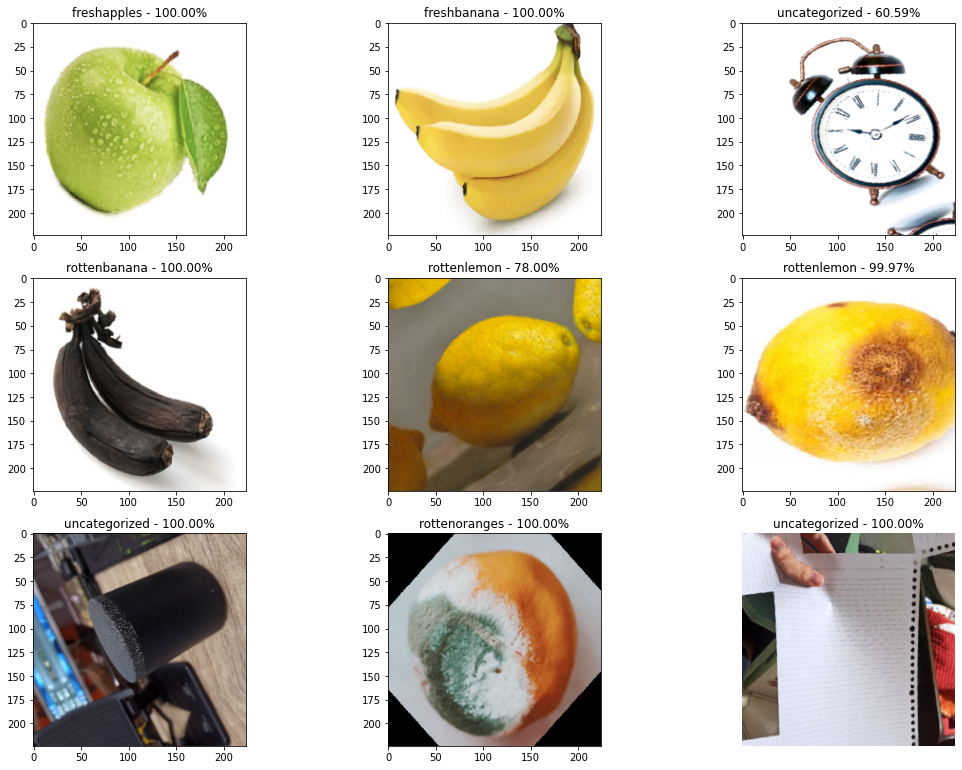

In [66]:
plt.figure(figsize=(18, 18))

num_index = 0
for images in tests:
  plt.subplot((len(tests)/3)+1, 3, num_index+1)
  plt.imshow(image.load_img(images, color_mode="rgb", target_size=(224,224), interpolation="nearest"))
  plt.title("{} - {:0.2f}%".format(class_names[predict_result[num_index]], percent[num_index]*100))
  num_index += 1
plt.axis('off')
plt.show()

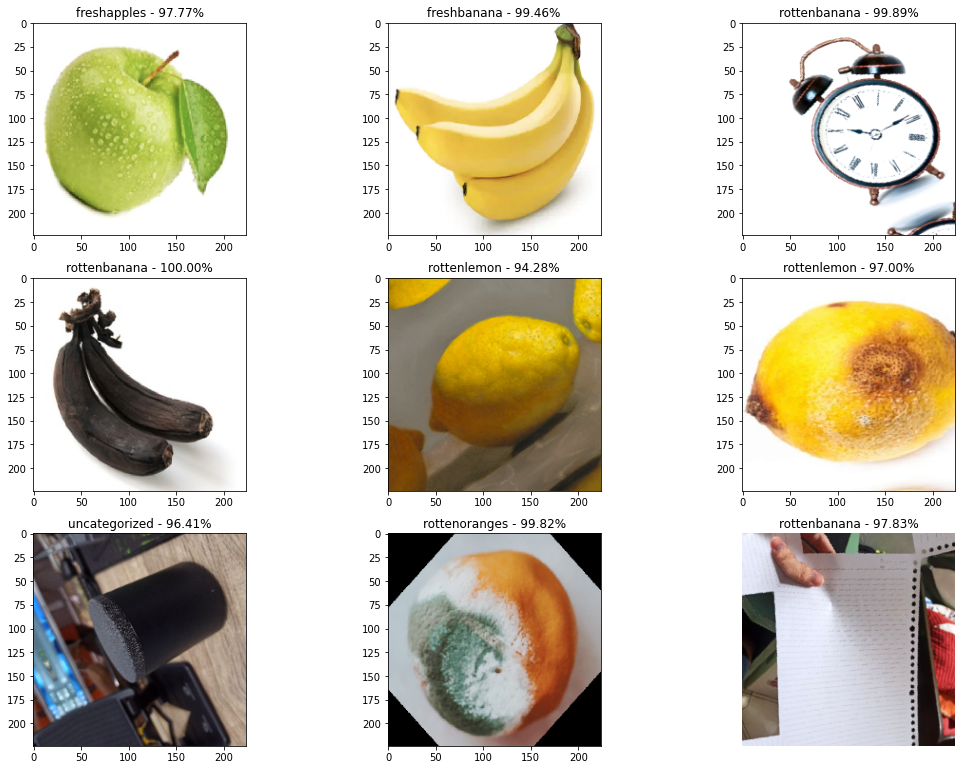

In [67]:
plt.figure(figsize=(18, 18))

num_index = 0
for images in tests:
  plt.subplot((len(tests)/3)+1, 3, num_index+1)
  plt.imshow(image.load_img(images, color_mode="rgb", target_size=(224,224), interpolation="nearest"))
  plt.title("{} - {:0.2f}%".format(class_names[predict_result2[num_index]], percent2[num_index]*100))
  num_index += 1
plt.axis('off')
plt.show()

## Saving model & converting to TFLite format & create labels

In [70]:
def save_model_func(model_var, model_name):
  os.chdir('/content')
  try:
    os.mkdir('models')
  except:
    pass
  model_var.save('models/{}'.format(model_name))

  converter = tf.lite.TFLiteConverter.from_saved_model('models/{}'.format(model_name))

  new_datagen = ImageDataGenerator(
    rescale=1./255
  )

  rep_flow = new_datagen.flow_from_directory(
    test_dir,
    batch_size=1,
    target_size=(224,224),
    shuffle=True,
    class_mode='categorical',
  )

  def representative_data_gen():
    for _ in range(300):
      img_with_label = rep_flow.next() # it returns (image and label) tuple
      yield [np.array(img_with_label[0], dtype=np.float32, ndmin=2)] # return only image
    
  converter.optimizations = [tf.lite.Optimize.DEFAULT]
  # converter.representative_dataset = representative_data_gen
  # converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS_INT8]
  # converter.inference_input_type = tf.uint8
  # converter.inference_output_type = tf.uint8

  tflite_model = converter.convert()

  with open('{}.tflite'.format(model_name), 'wb') as f:
    f.write(tflite_model)

  files.download('{}.tflite'.format(model_name))

  with open('labels.txt', 'w') as f:
    f.write('\n'.join(class_names))

  files.download('labels.txt')
  return tflite_model

In [72]:
lite_model = save_model_func(model, 'mobilenetv3_edit_v2')
lite_model2 = save_model_func(model2, 'custom_model_v2')

INFO:tensorflow:Assets written to: models/mobilenetv3_edit_v2/assets


INFO:tensorflow:Assets written to: models/mobilenetv3_edit_v2/assets


Found 3318 images belonging to 9 classes.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

INFO:tensorflow:Assets written to: models/custom_model_v2/assets


INFO:tensorflow:Assets written to: models/custom_model_v2/assets


Found 3318 images belonging to 9 classes.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [73]:
!zip -r /content/mobilenetv3_edit_v2.zip /content/models/mobilenetv3_edit_v2
!zip -r /content/custom_model_v2.zip /content/models/custom_model_v2

  adding: content/models/mobilenetv3_edit_v2/ (stored 0%)
  adding: content/models/mobilenetv3_edit_v2/variables/ (stored 0%)
  adding: content/models/mobilenetv3_edit_v2/variables/variables.data-00000-of-00001 (deflated 7%)
  adding: content/models/mobilenetv3_edit_v2/variables/variables.index (deflated 77%)
  adding: content/models/mobilenetv3_edit_v2/assets/ (stored 0%)
  adding: content/models/mobilenetv3_edit_v2/keras_metadata.pb (deflated 87%)
  adding: content/models/mobilenetv3_edit_v2/saved_model.pb (deflated 92%)
  adding: content/models/custom_model_v2/ (stored 0%)
  adding: content/models/custom_model_v2/variables/ (stored 0%)
  adding: content/models/custom_model_v2/variables/variables.data-00000-of-00001 (deflated 24%)
  adding: content/models/custom_model_v2/variables/variables.index (deflated 67%)
  adding: content/models/custom_model_v2/assets/ (stored 0%)
  adding: content/models/custom_model_v2/keras_metadata.pb (deflated 93%)
  adding: content/models/custom_model_v2

## (Optional) Load model

In [76]:
model = tf.keras.models.load_model('/gdrive/MyDrive/Kaggle/models/mobilenet_v2/mobilenetv3_edit_v2')
model2 = tf.keras.models.load_model('/gdrive/MyDrive/Kaggle/models/custom_model_v2/custom_model_v2')

lite_model = tf.lite.Interpreter(model_path='/gdrive/MyDrive/Kaggle/models/mobilenet_v2/mobilenetv3_edit_v2.tflite')
lite_model2 = tf.lite.Interpreter(model_path='/gdrive/MyDrive/Kaggle/models/custom_model_v2/custom_model_v2.tflite')

## Testing model

## Converting to TFLite format & create labels



In [ ]:
# converter = tf.lite.TFLiteConverter.from_saved_model('models/project_model_v3')
# tflite_model = converter.convert()

# with open('model_v3.tflite', 'wb') as f:
#   f.write(tflite_model)

# files.download('model_v3.tflite')

# with open('labels.txt', 'w') as f:
#   f.write('\n'.join(class_names))

# files.download('labels.txt')

## Trying out the TFLite model

In [92]:
# interpreter = tf.lite.Interpreter(model_content=lite_model)
interpreter = lite_model

interpreter.allocate_tensors()

input_details = interpreter.get_input_details()[0]
output_details = interpreter.get_output_details()[0]

predictions = []

rep_flow = test_datagen.flow_from_directory(
  test_dir,
  batch_size=1,
  target_size=(224,224),
  shuffle=True,
  class_mode='categorical',
)

test_labels, test_imgs = [], []
for _ in range(10):
  image_file = list(rep_flow.next())
  test_imgs.append(image_file[0])
  print(image_file[1])
  test_labels.append(np.argmax(image_file[1]))

  if input_details['dtype'] == np.uint8:
    input_scale, input_zero_point = input_details['quantization']
    image_file[0] = image_file[0] / input_scale + input_zero_point
  
  image_file[0] = image_file[0].astype(input_details['dtype'])
  interpreter.set_tensor(input_details['index'], image_file[0])
  interpreter.invoke()
  output = interpreter.get_tensor(output_details['index'])[0]
  predictions.append(output)

Found 3318 images belonging to 9 classes.
[[0. 0. 0. 0. 1. 0. 0. 0. 0.]]
[[0. 0. 0. 0. 1. 0. 0. 0. 0.]]
[[0. 0. 0. 0. 0. 1. 0. 0. 0.]]
[[1. 0. 0. 0. 0. 0. 0. 0. 0.]]
[[0. 1. 0. 0. 0. 0. 0. 0. 0.]]
[[0. 0. 1. 0. 0. 0. 0. 0. 0.]]
[[1. 0. 0. 0. 0. 0. 0. 0. 0.]]
[[0. 1. 0. 0. 0. 0. 0. 0. 0.]]
[[1. 0. 0. 0. 0. 0. 0. 0. 0.]]
[[0. 0. 0. 0. 0. 0. 0. 0. 1.]]


In [93]:
def plot_image(i, predictions_array, true_label, img):
    predictions_array, true_label, img = predictions_array[i], true_label[i], img[i]
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    img = np.squeeze(img)
    
    plt.imshow(img, cmap=plt.cm.binary)
    
    predicted_label = np.argmax(predictions_array)
    
    print(type(predicted_label), type(true_label))
        
    plt.xlabel("{} {:0.2f}% ({})".format(class_names[predicted_label],
                                         np.max(predictions_array)*100,
                                         class_names[true_label]))

<class 'numpy.int64'> <class 'numpy.int64'>


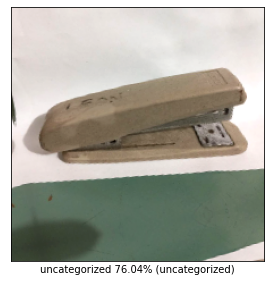

In [104]:
#@title Visualize the outputs { run: "auto" }
index = 9 #@param {type:"slider", min:0, max:9, step:1}
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plot_image(index, predictions, test_labels, test_imgs)
plt.show()

## Get TFLite model input and output shapes

In [ ]:
import tensorflow as tf
from google.colab import files
import numpy as np
from keras.preprocessing import image

files.upload()

Saving mobilenetv3_edit_v1.tflite to mobilenetv3_edit_v1 (1).tflite


{'mobilenetv3_edit_v1.tflite': b'$\x00\x00\x00TFL3\x00\x00\x00\x00\x00\x00\x00\x00\x14\x00 \x00\x04\x00\x08\x00\x0c\x00\x10\x00\x14\x00\x00\x00\x18\x00\x1c\x00\x14\x00\x00\x00\x03\x00\x00\x00\x80)Q\x00\xe0\x0eK\x00\xc8\x0eK\x00\xc4\x00\x00\x00\x8c\x00\x00\x00\x04\x00\x00\x00\x01\x00\x00\x00\x04\x00\x00\x00\x18\xe6\xae\xffP\x00\x00\x00,\x00\x00\x00\x14\x00\x00\x00\x04\x00\x00\x00\x05\x00\x00\x00serve\x00\x00\x00\x0f\x00\x00\x00serving_default\x00\x01\x00\x00\x00\x04\x00\x00\x00\xb8\xff\xff\xff\x08\x00\x00\x00\x0e\x01\x00\x00\x07\x00\x00\x00dense_1\x00\x01\x00\x00\x00\x04\x00\x00\x00&\xef\xb4\xff\x04\x00\x00\x00\x11\x00\x00\x00keras_layer_input\x00\x00\x00\x01\x00\x00\x00\x0c\x00\x00\x00\x08\x00\x0c\x00\x04\x00\x08\x00\x08\x00\x00\x00\x08\x00\x00\x00\x10\x01\x00\x00\x13\x00\x00\x00min_runtime_version\x00\x11\x01\x00\x00\xec\rK\x00\xd8\rK\x00\x9c\rK\x00\x88\x05K\x00\xf4\x04K\x00`\x04K\x00\xec\x03K\x00\x18\x00K\x00D\xfcJ\x00\x90\xf9J\x00\xdc\xf6J\x00\xe8\xf4J\x00\xd4\xf4J\x00\xb0\xf4J\x00\

In [105]:
interpreter = tf.lite.Interpreter(model_path="/content/custom_model_v2.tflite")
interpreter.allocate_tensors()

# Print input shape and type
inputs = interpreter.get_input_details()
print('{} input(s):'.format(len(inputs)))
for i in range(0, len(inputs)):
    print('{} {}'.format(inputs[i]['shape'], inputs[i]['dtype']))

# Print output shape and type
outputs = interpreter.get_output_details()
print('\n{} output(s):'.format(len(outputs)))
for i in range(0, len(outputs)):
    print('{} {}'.format(outputs[i]['shape'], outputs[i]['dtype']))

1 input(s):
[  1 224 224   3] <class 'numpy.float32'>

1 output(s):
[1 9] <class 'numpy.float32'>


## Get model weights

In [ ]:
from google.colab import drive
import tensorflow as tf

drive.mount('/gdrive')

model = tf.keras.models.load_model('/gdrive/MyDrive/Kaggle/models/custom_model_v1/custom_model_v1')
model.save_weights('fruit_classification_custom')

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).
